# Visualization Program for RetinaNet

In [10]:
import os
import math
import json
import collections
from PIL import Image
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import torch.nn as nn
import torch
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter
from torch.optim.lr_scheduler import LambdaLR
import torchvision.transforms.functional as F_transform
import numpy as np
from tqdm import tqdm
from pycocotools.coco import COCO
import gc
from torch.utils.data.sampler import Sampler
import random 
import torch
import pytorch_lightning as pl
import torchvision
from transformers import AutoModelForObjectDetection,AutoImageProcessor
from datetime import datetime

import argparse
import collections

from retinanet import model
from retinanet.dataloader import CocoDataset, CSVDataset, collater, Resizer, AspectRatioBasedSampler, Augmenter, \
    Normalizer
from torch.utils.data import DataLoader

from retinanet import coco_eval
from retinanet import csv_eval
import matplotlib.pyplot as plt

#* Ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [17]:
import torch
import numpy as np
import time
import os
import csv
import cv2
import argparse
import random
from pycocotools.coco import COCO
import json


def load_classes(csv_reader):
    result = {}
    for line, row in enumerate(csv_reader):
        line += 1
        try:
            class_name, class_id = row
        except ValueError:
            raise(ValueError(f'line {line}: format should be \'class_name,class_id\''))
        class_id = int(class_id)
        if class_name in result:
            raise ValueError(f'line {line}: duplicate class name: \'{class_name}\'')
        result[class_name] = class_id
    return result


def draw_caption(image, box, caption, color=(255, 255, 255)):
    b = np.array(box).astype(int)
    cv2.putText(image, caption, (b[0], b[1] - 10), cv2.FONT_HERSHEY_PLAIN, 1, (0, 0, 0), 2)
    cv2.putText(image, caption, (b[0], b[1] - 10), cv2.FONT_HERSHEY_PLAIN, 1, color, 1)


def preprocess_image(image, min_side=608, max_side=1024):
    rows, cols, cns = image.shape
    smallest_side = min(rows, cols)
    scale = min_side / smallest_side
    if max(rows, cols) * scale > max_side:
        scale = max_side / max(rows, cols)
    image = cv2.resize(image, (int(round(cols * scale)), int(round(rows * scale))))
    rows, cols, cns = image.shape
    pad_w = 32 - rows % 32
    pad_h = 32 - cols % 32
    new_image = np.zeros((rows + pad_w, cols + pad_h, cns)).astype(np.float32)
    new_image[:rows, :cols, :] = image.astype(np.float32)
    image = new_image / 255.0
    image -= [0.485, 0.456, 0.406]
    image /= [0.229, 0.224, 0.225]
    image = np.transpose(image, (2, 0, 1))
    return image, scale


def detect_and_compare(image_dir, model_path, annotation_path):
    # Load COCO annotations
    coco = COCO(annotation_path)

    # Derive labels from categories
    cats = coco.loadCats(coco.getCatIds())
    labels = {i: cat['name'] for i, cat in enumerate(cats)}


    # Load model
    model = torch.load(model_path,weights_only=False)
    if torch.cuda.is_available():
        model = model.cuda()
    model.eval()

    # Select 12 images
    image_ids = coco.getImgIds()
    selected_ids = random.sample(image_ids, 12)

    for img_id in selected_ids:
        img_meta = coco.loadImgs(img_id)[0]
        img_path = os.path.join(image_dir, img_meta['file_name'])
        image_orig = cv2.imread(img_path)
        if image_orig is None:
            continue

        image, scale = preprocess_image(image_orig.copy())
        image_tensor = torch.from_numpy(image).unsqueeze(0).float()
        if torch.cuda.is_available():
            image_tensor = image_tensor.cuda()

        with torch.no_grad():
            scores, classification, transformed_anchors = model(image_tensor)

        scores = scores.cpu().numpy()
        classification = classification.cpu().numpy()
        transformed_anchors = transformed_anchors.cpu().numpy()

        # Draw predictions
        for j in range(len(scores)):
            if scores[j] < 0.5:
                continue
            bbox = transformed_anchors[j]
            x1, y1, x2, y2 = [int(b / scale) for b in bbox]
            class_idx = int(classification[j])
            caption = f'{labels[class_idx]} {scores[j]:.2f}'
            draw_caption(image_orig, (x1, y1, x2, y2), caption, color=(0, 0, 255))
            cv2.rectangle(image_orig, (x1, y1), (x2, y2), (0, 0, 255), 2)

        # Draw ground truth
        ann_ids = coco.getAnnIds(imgIds=[img_id])
        anns = coco.loadAnns(ann_ids)
        for ann in anns:
            x, y, w, h = ann['bbox']
            x1, y1, x2, y2 = int(x), int(y), int(x + w), int(y + h)
            class_id = ann['category_id']
            class_name = coco.loadCats([class_id])[0]['name']
            draw_caption(image_orig, (x1, y1, x2, y2), class_name, color=(0, 255, 0))
            cv2.rectangle(image_orig, (x1, y1), (x2, y2), (0, 255, 0), 2)

        
        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(image_orig, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()
image_dir = '/home/toni_intern/datasets/test'
model_path = '/home/toni_intern/RetinaNet/chosen_epoch_weights/coco_retinanet_depth_101_epoch_50.pt'

# 🟩 Summary of Colors:

- **Red boxes** = model predictions.

- **Green boxes** = ground truth annotations.

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


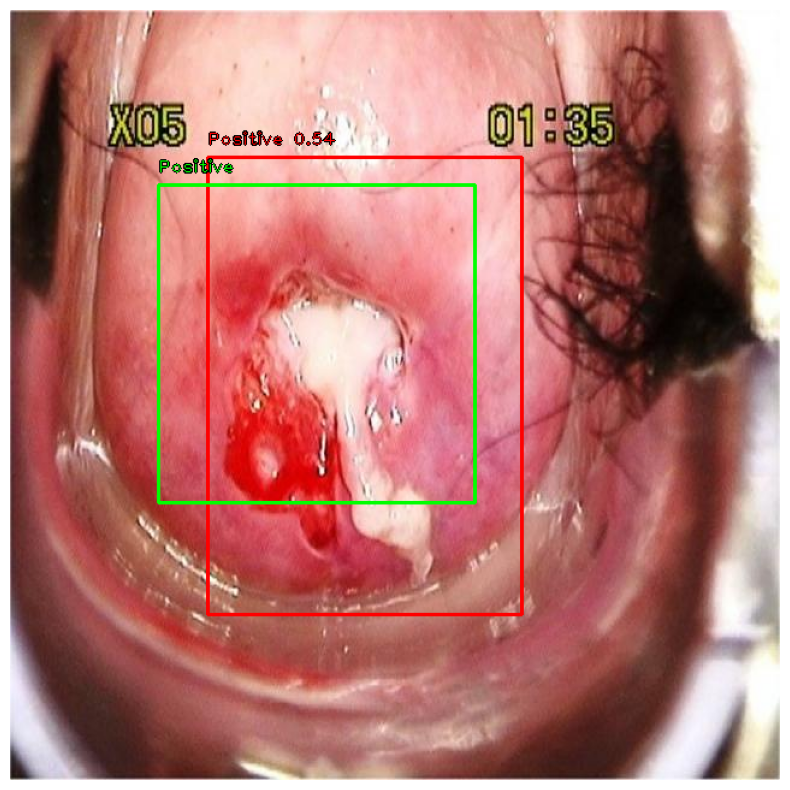

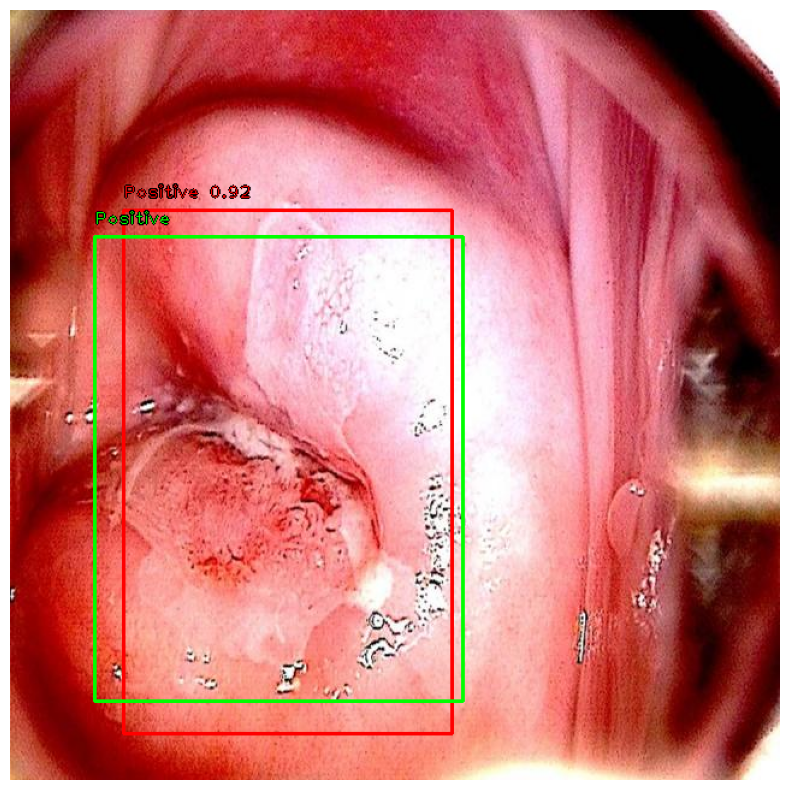

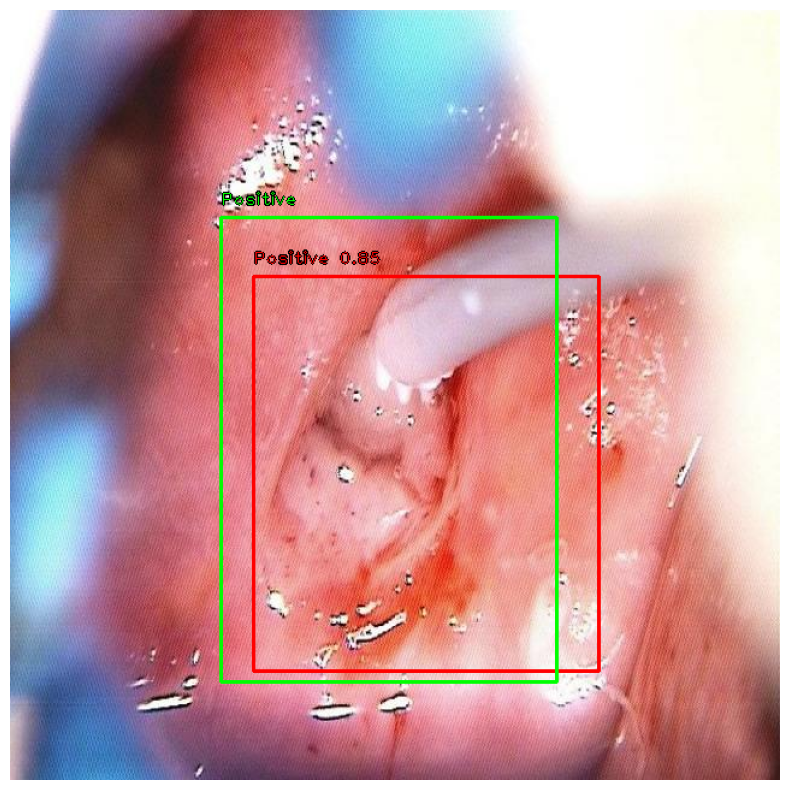

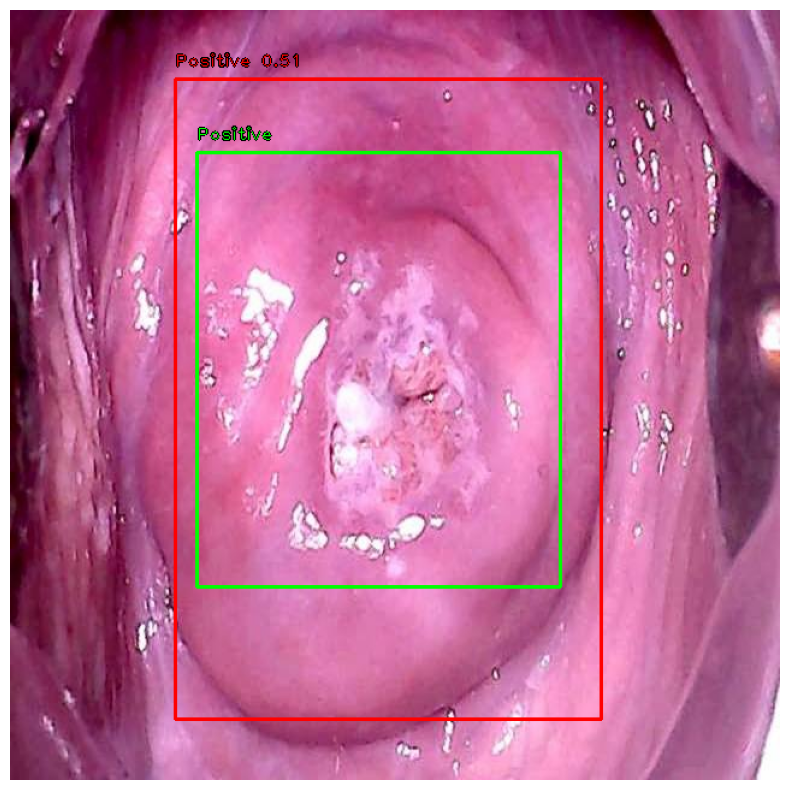

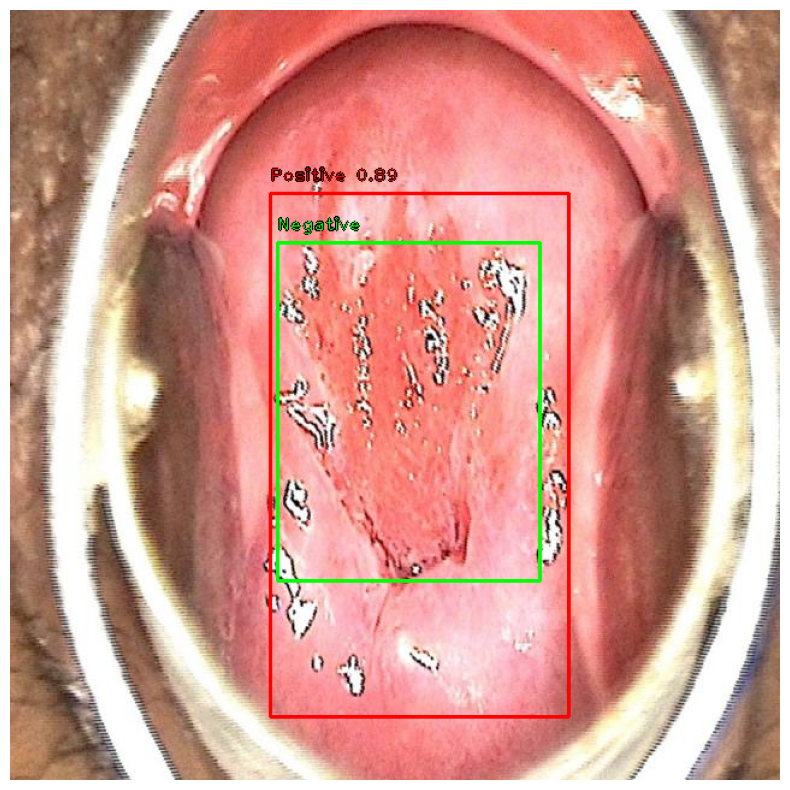

...

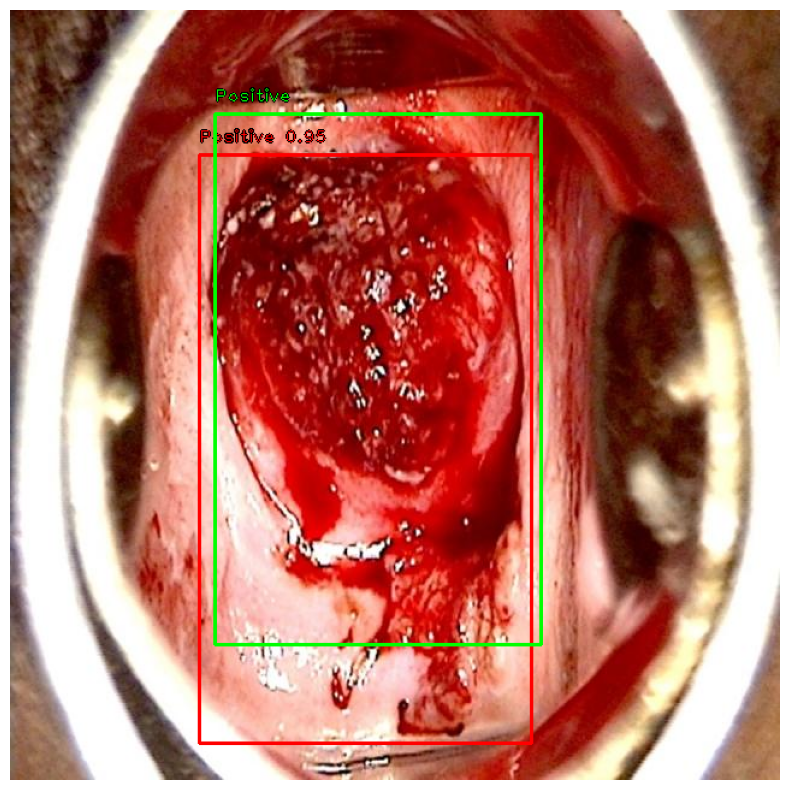

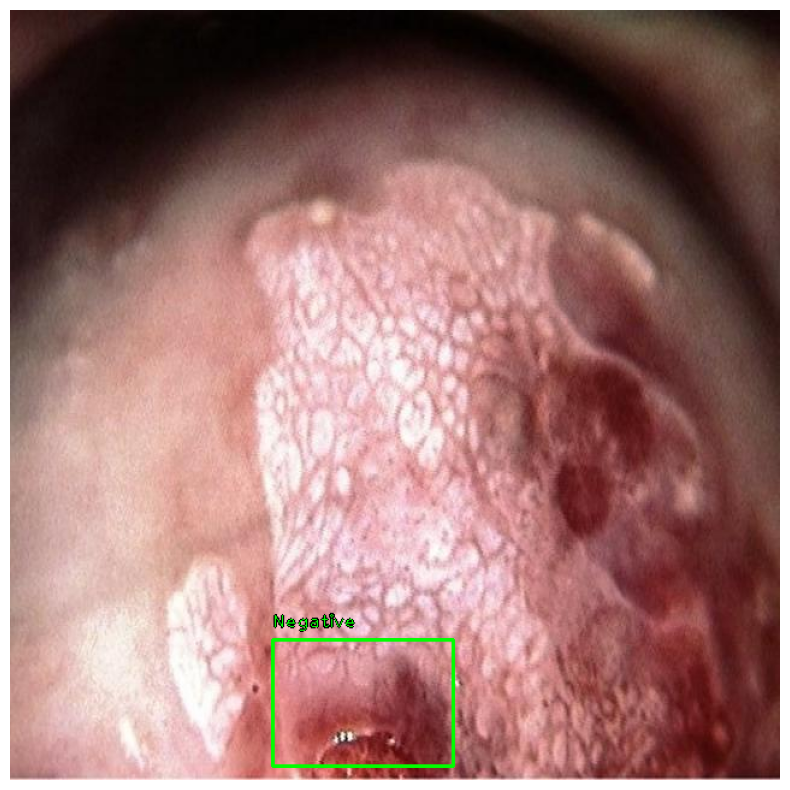

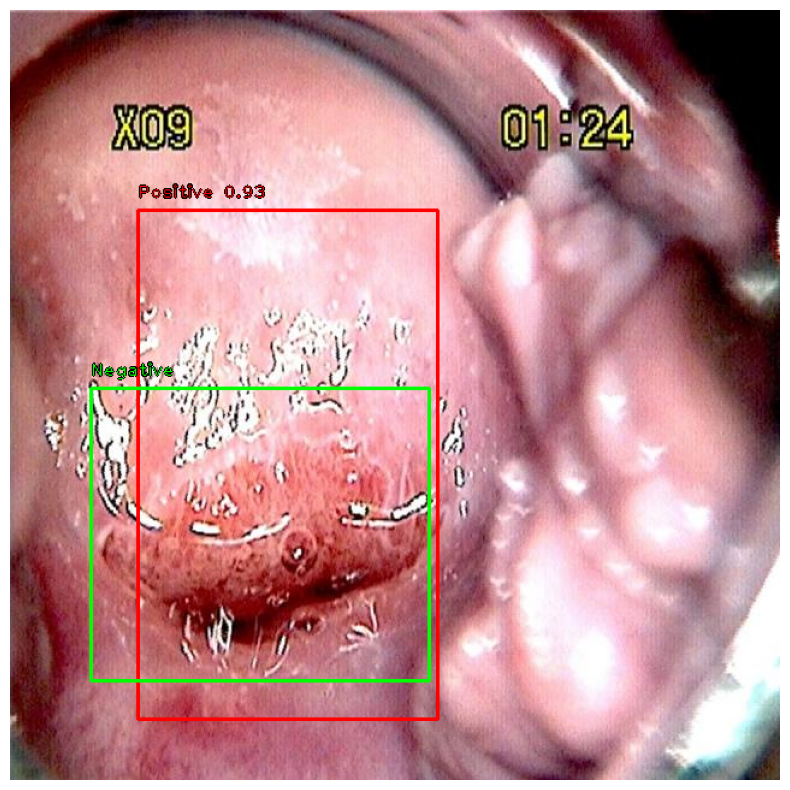

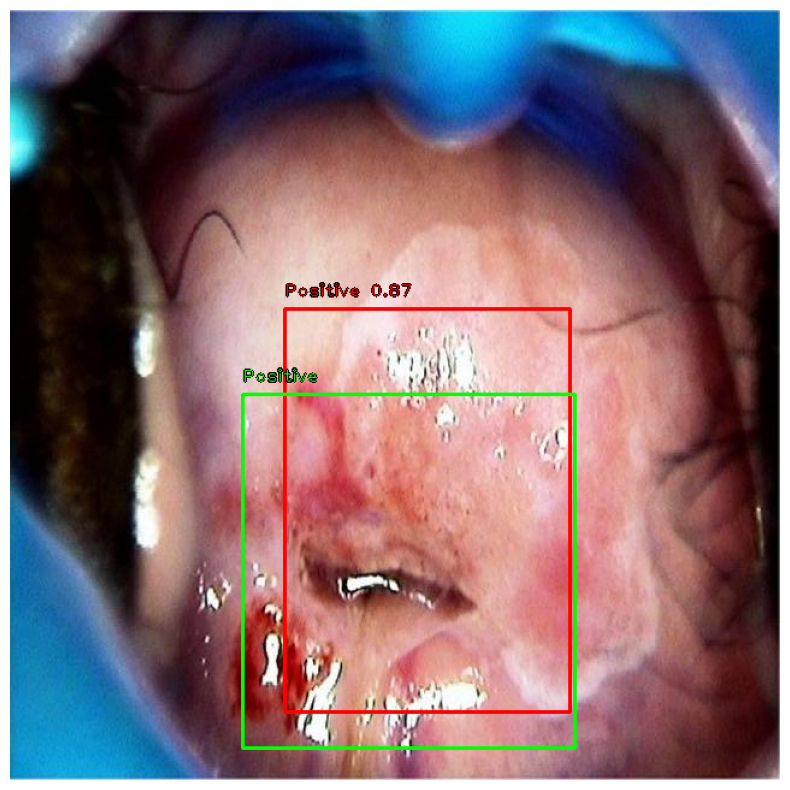

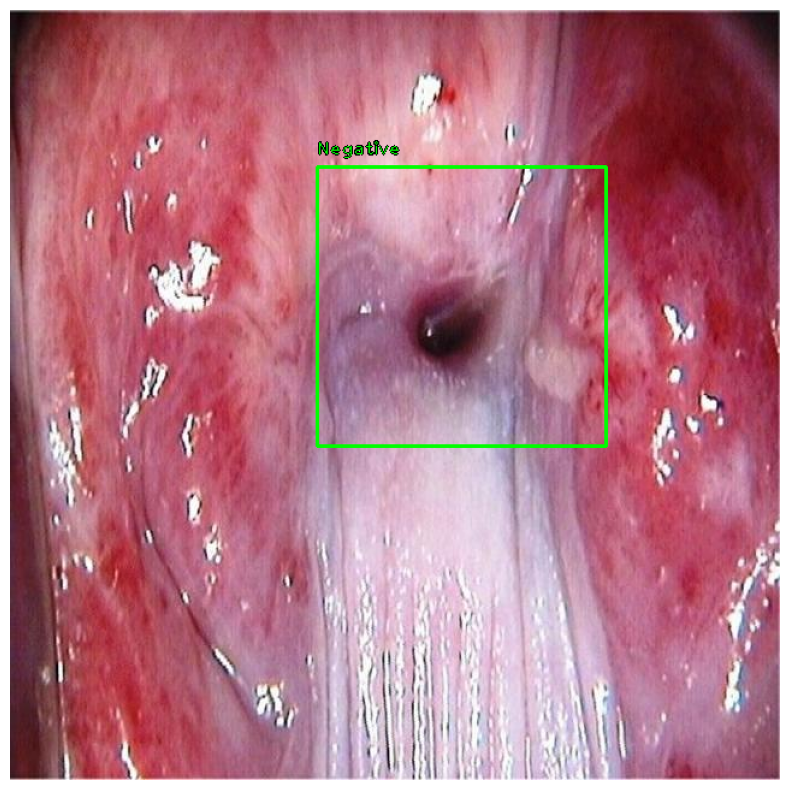

In [15]:
detect_and_compare(image_dir, model_path, f'{image_dir}/_annotations.coco.json')

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


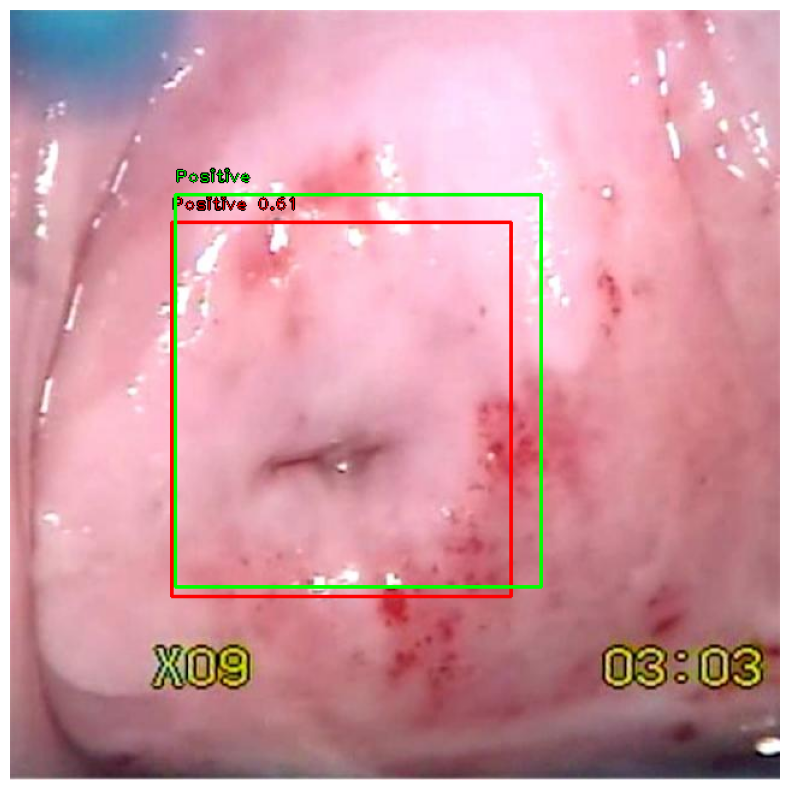

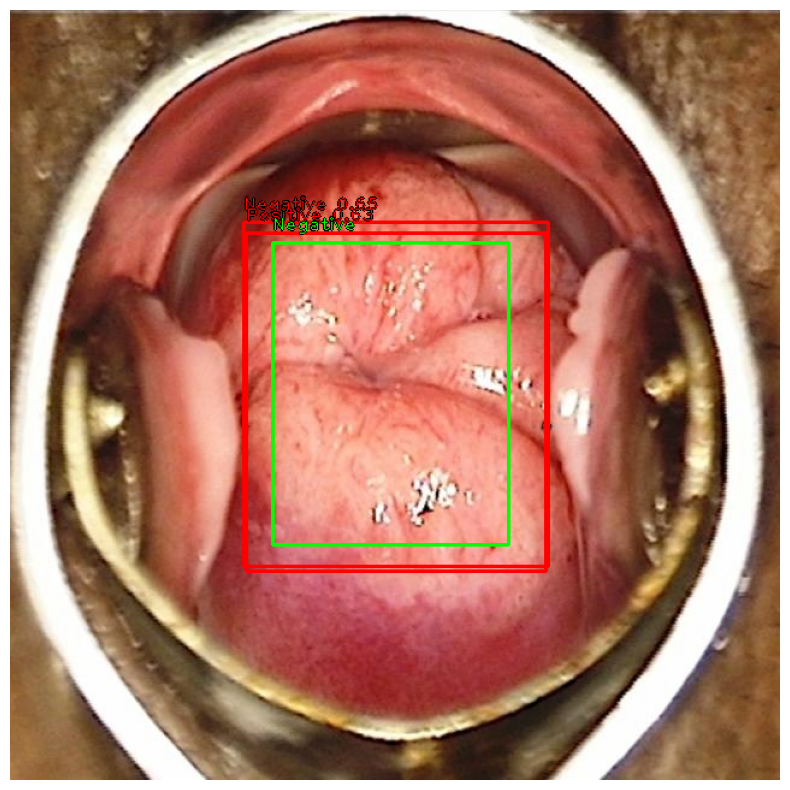

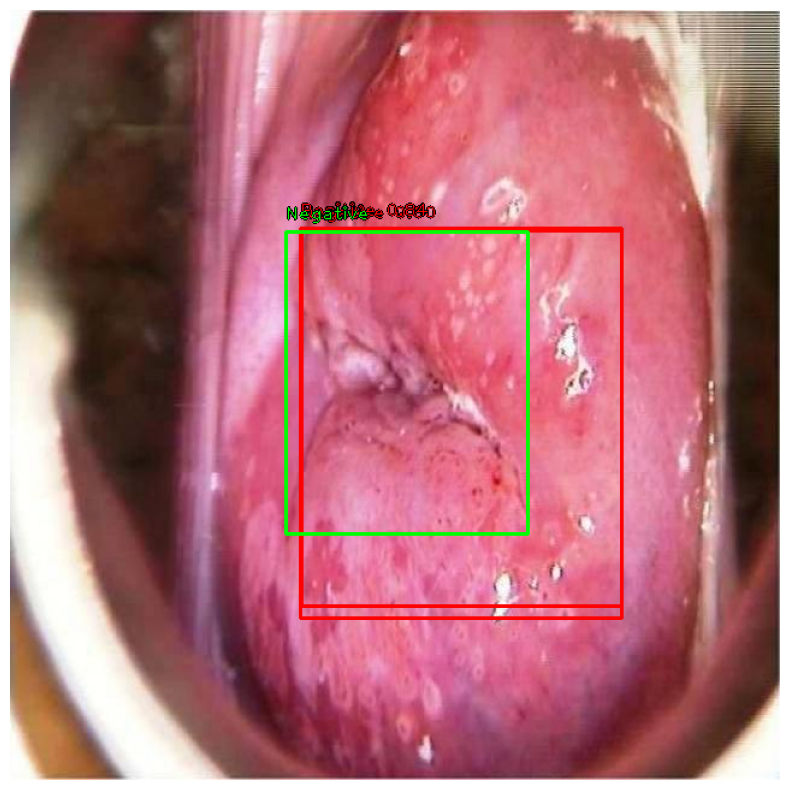

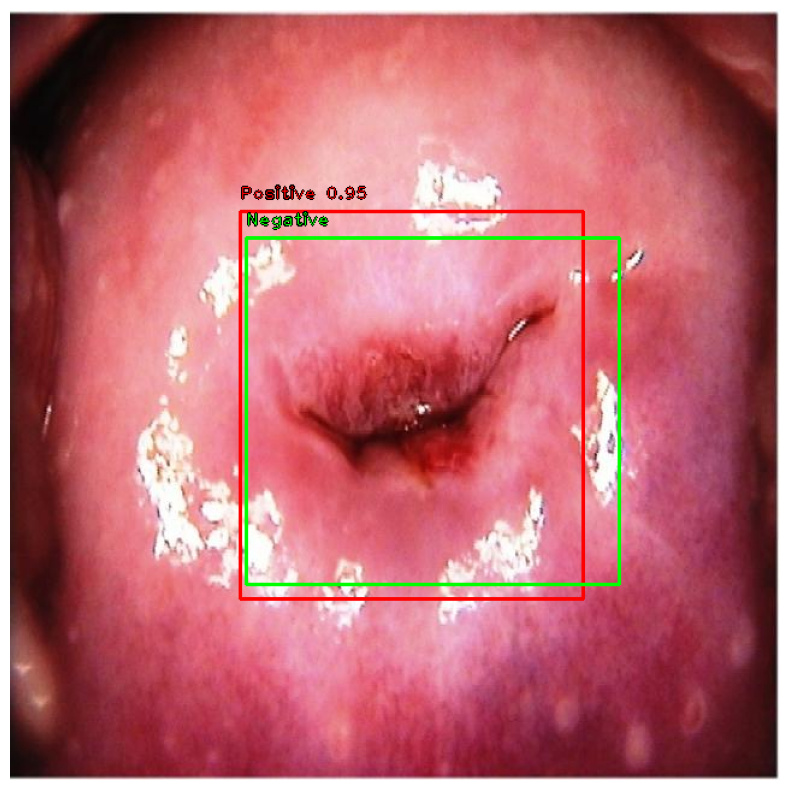

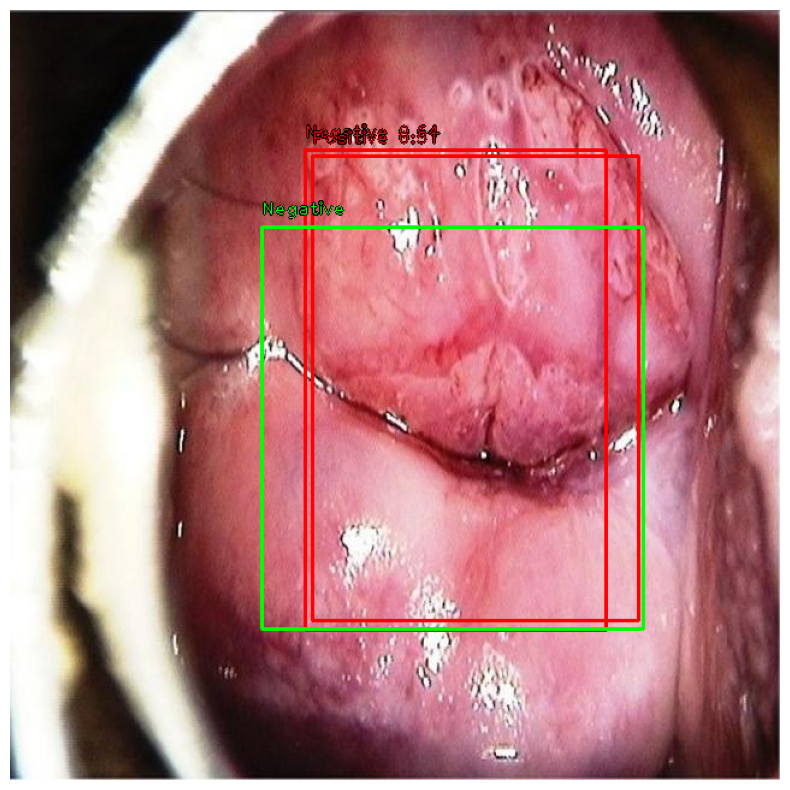

...

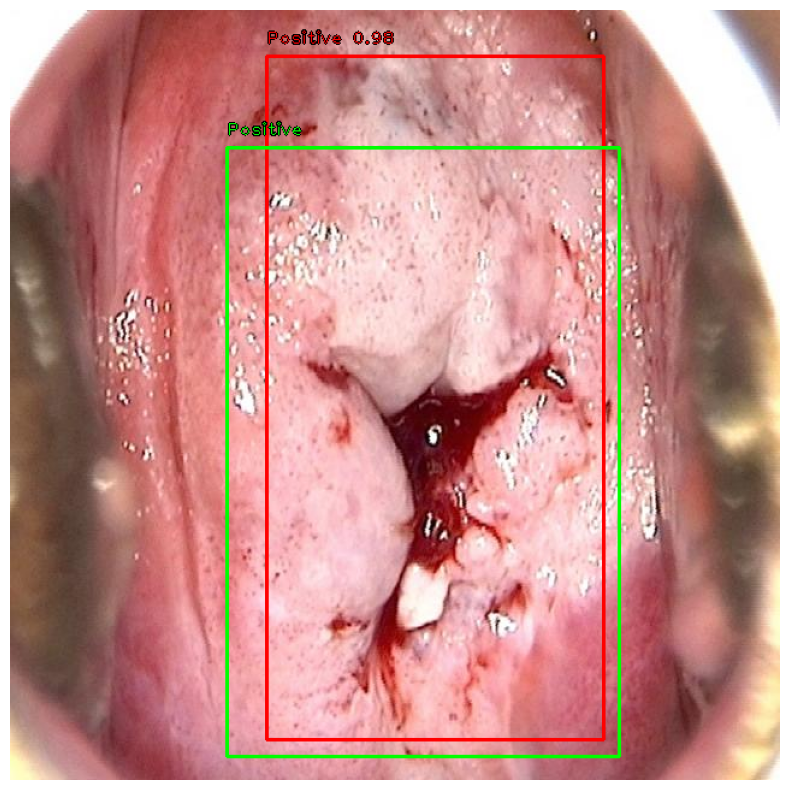

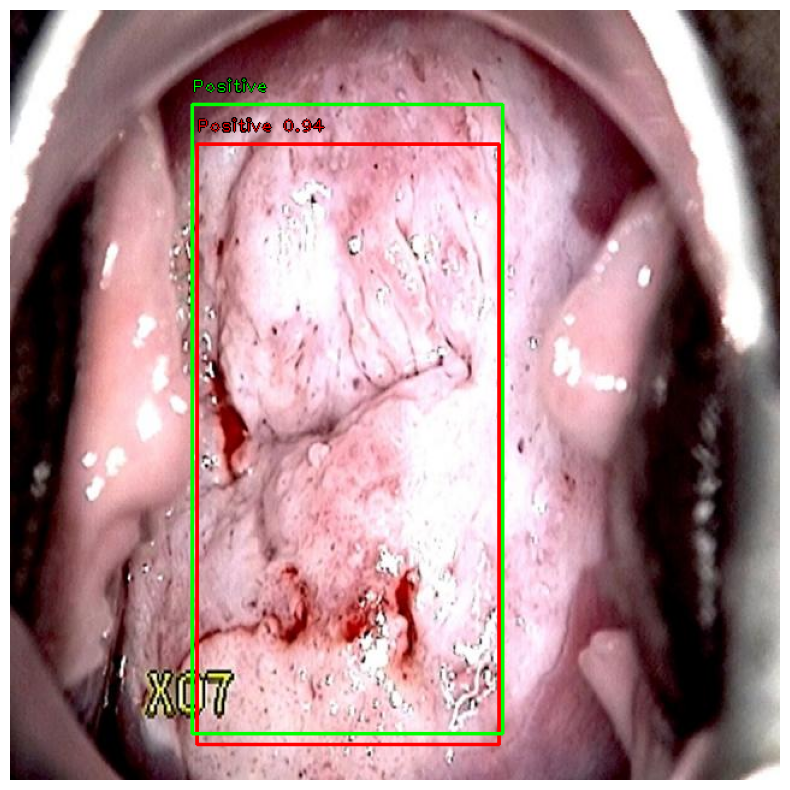

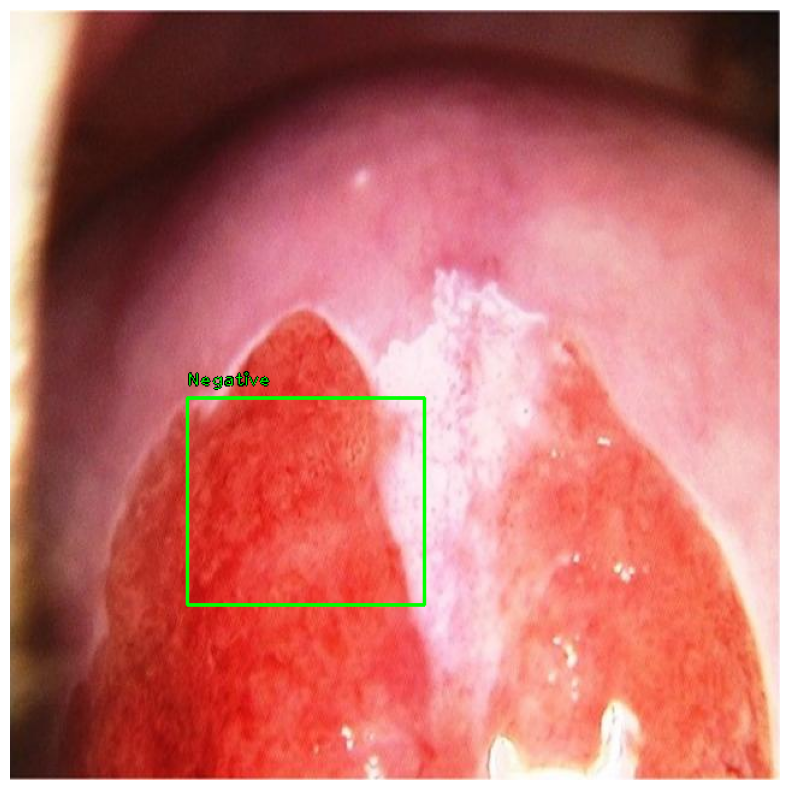

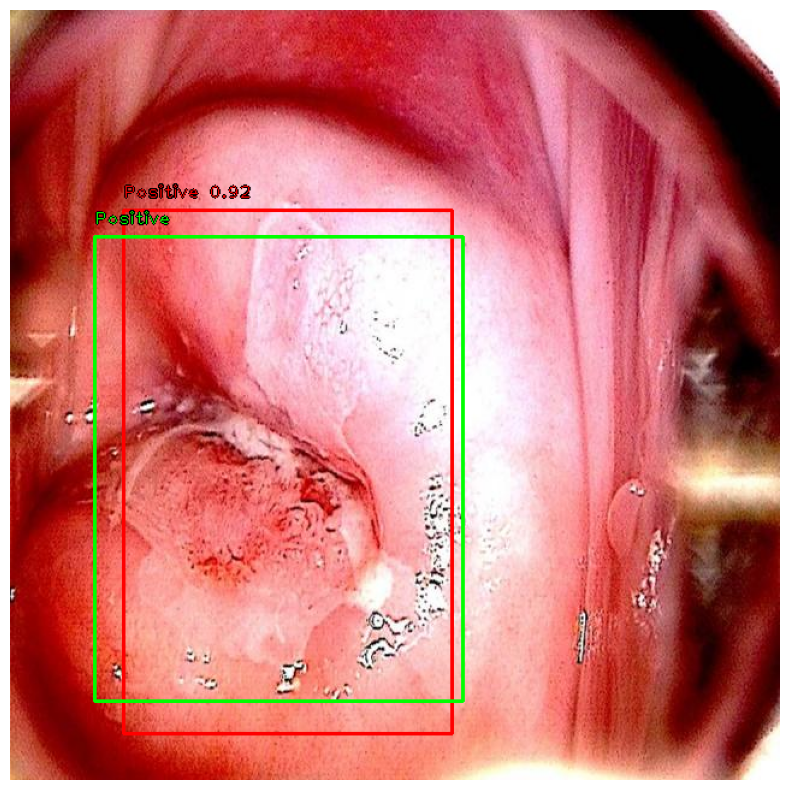

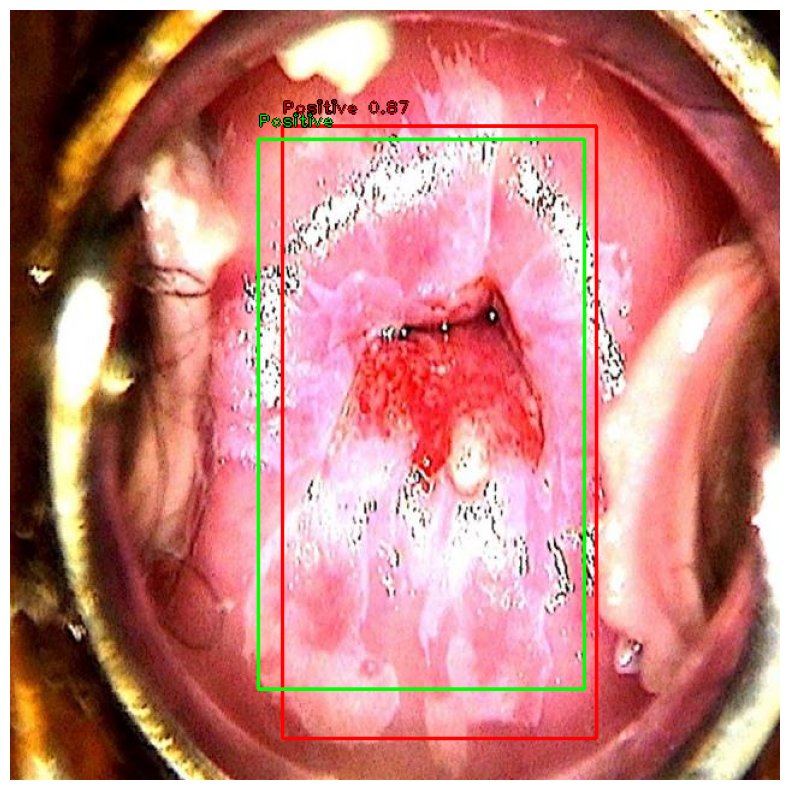

In [20]:
model_path = '/home/toni_intern/RetinaNet/chosen_epoch_weights/coco_retinanet_depth_101_epoch_14.pt'
detect_and_compare(image_dir, model_path, f'{image_dir}/_annotations.coco.json')

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


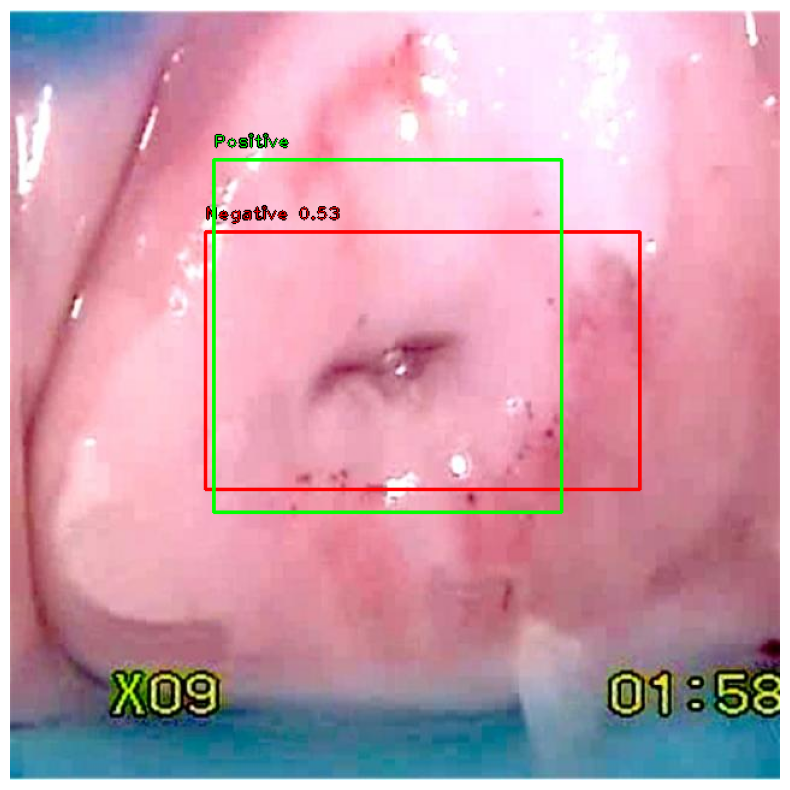

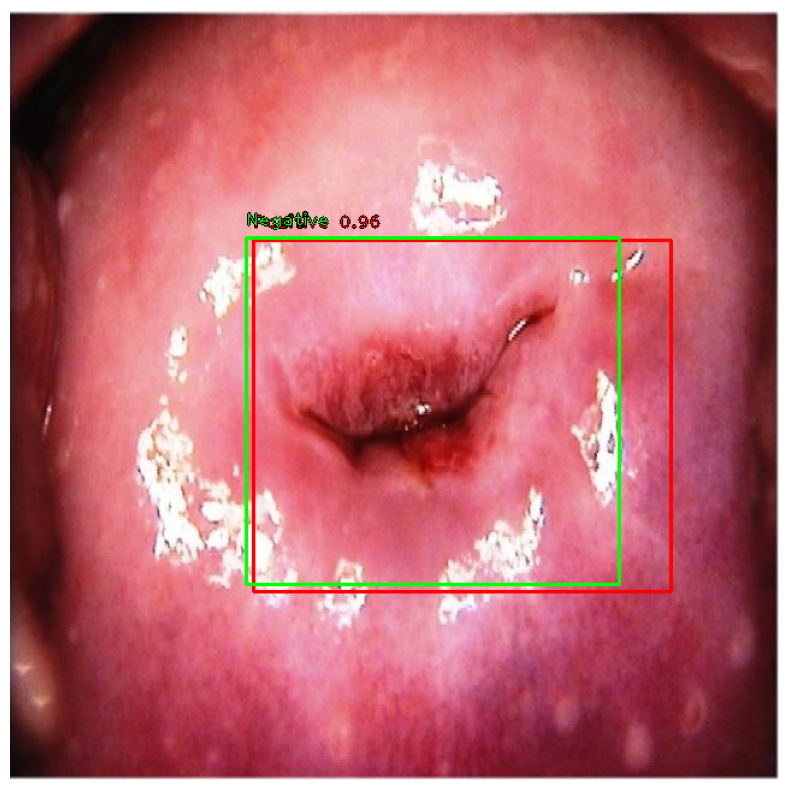

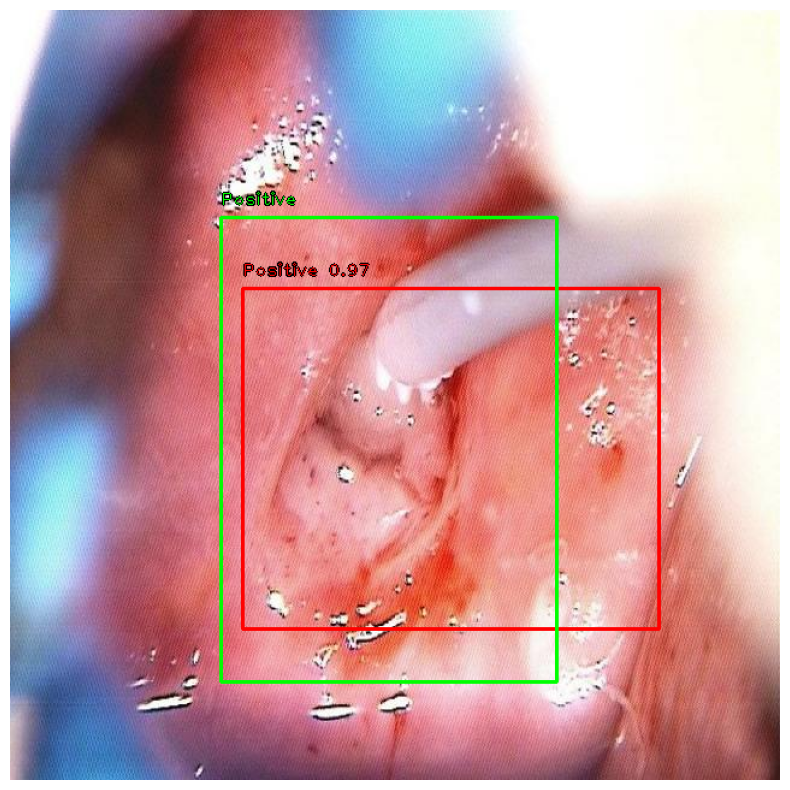

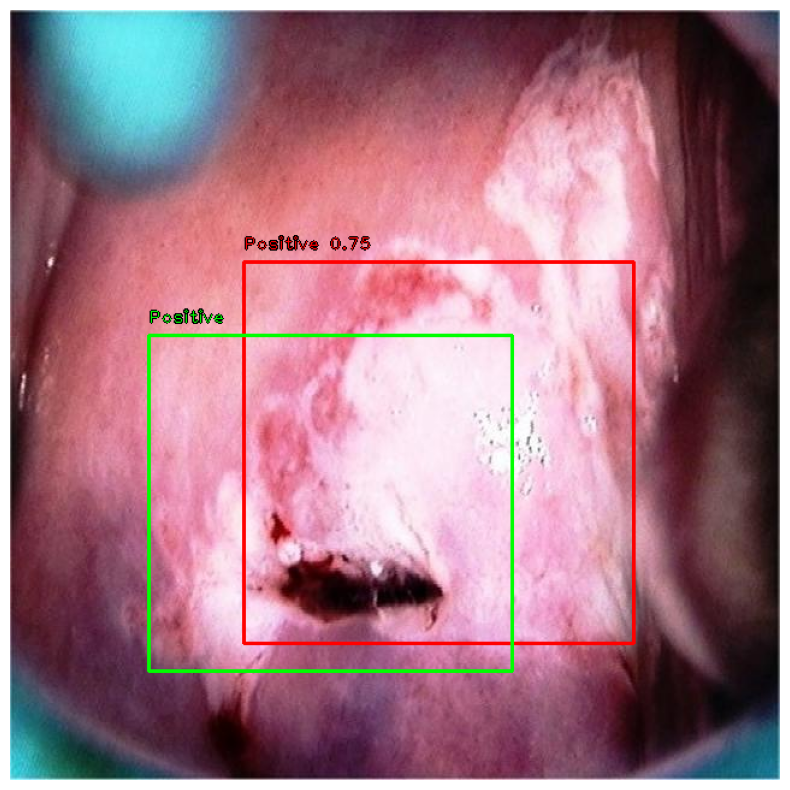

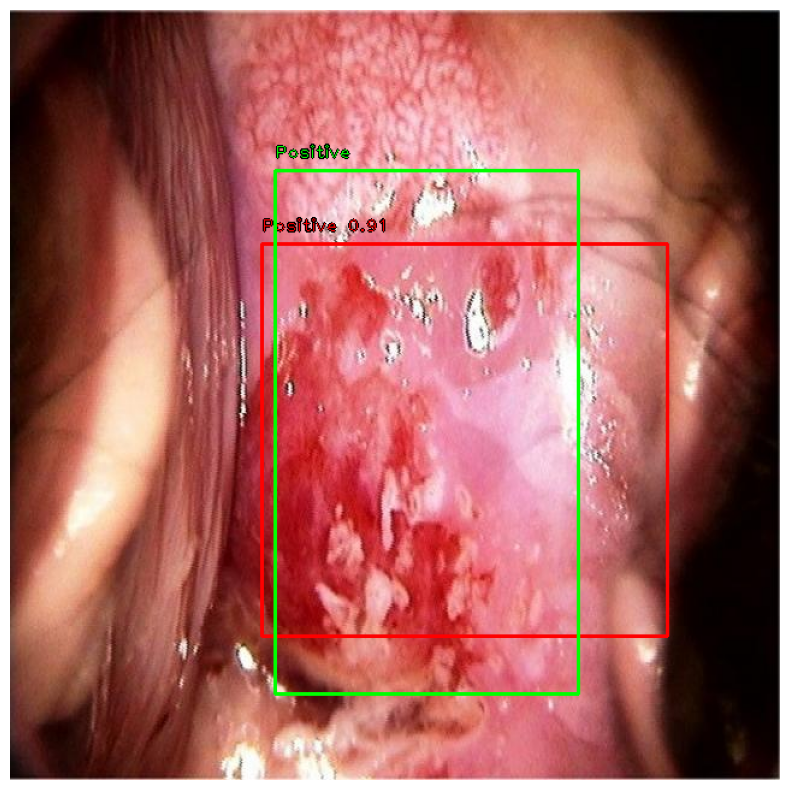

...

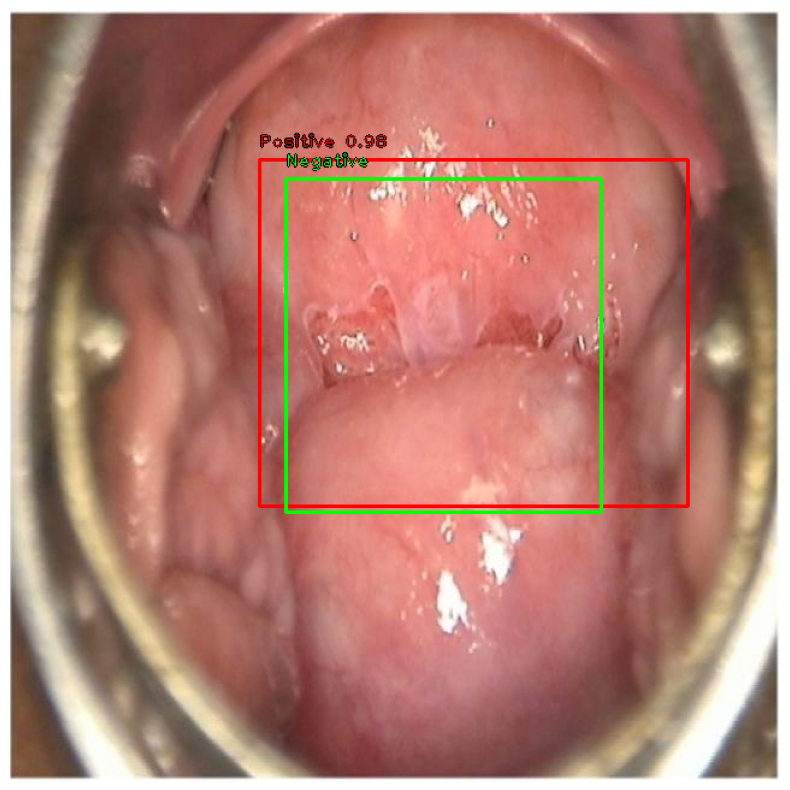

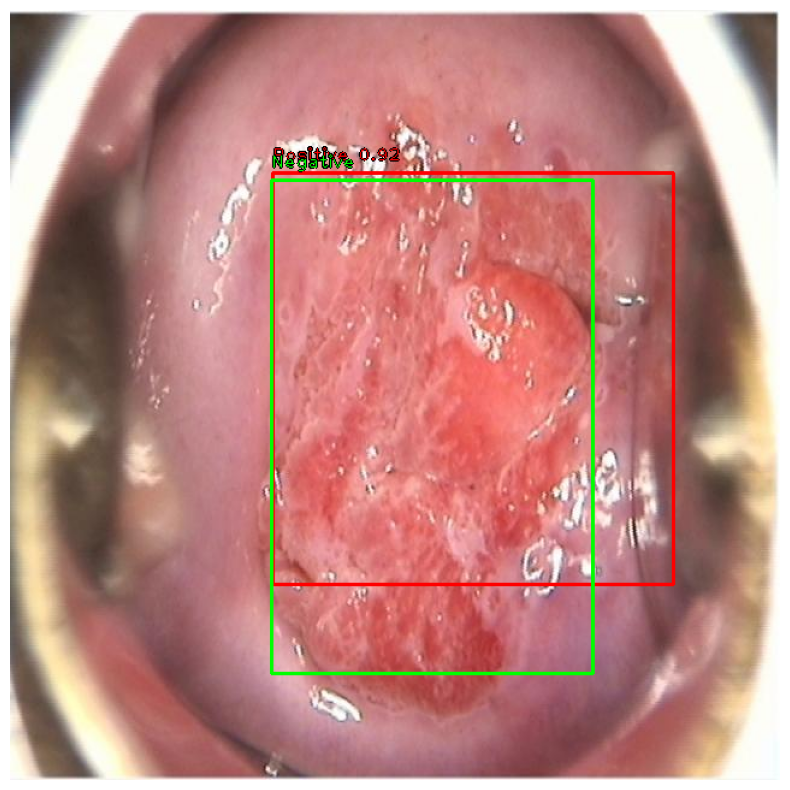

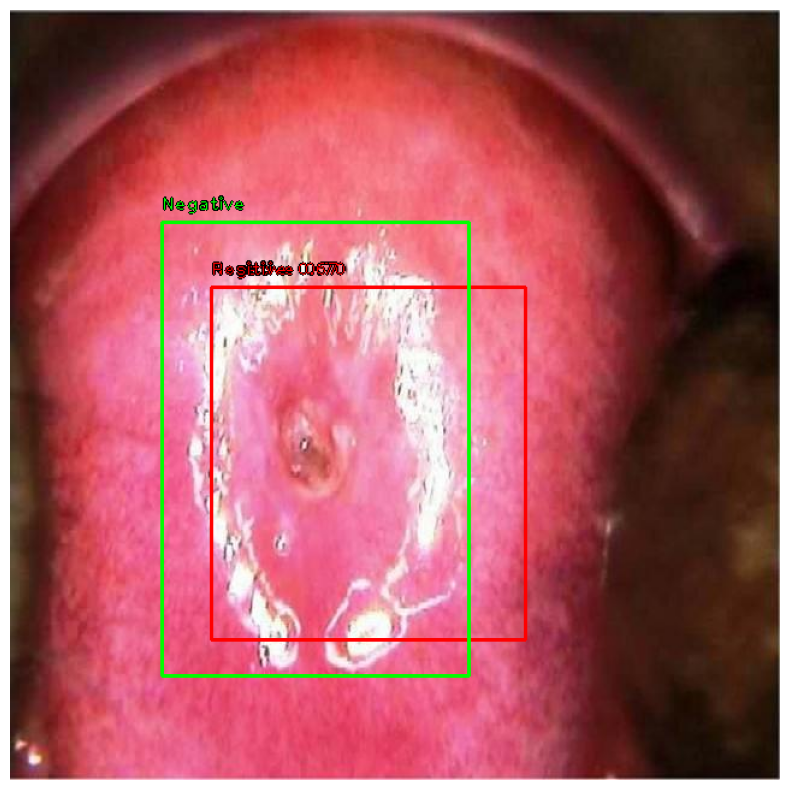

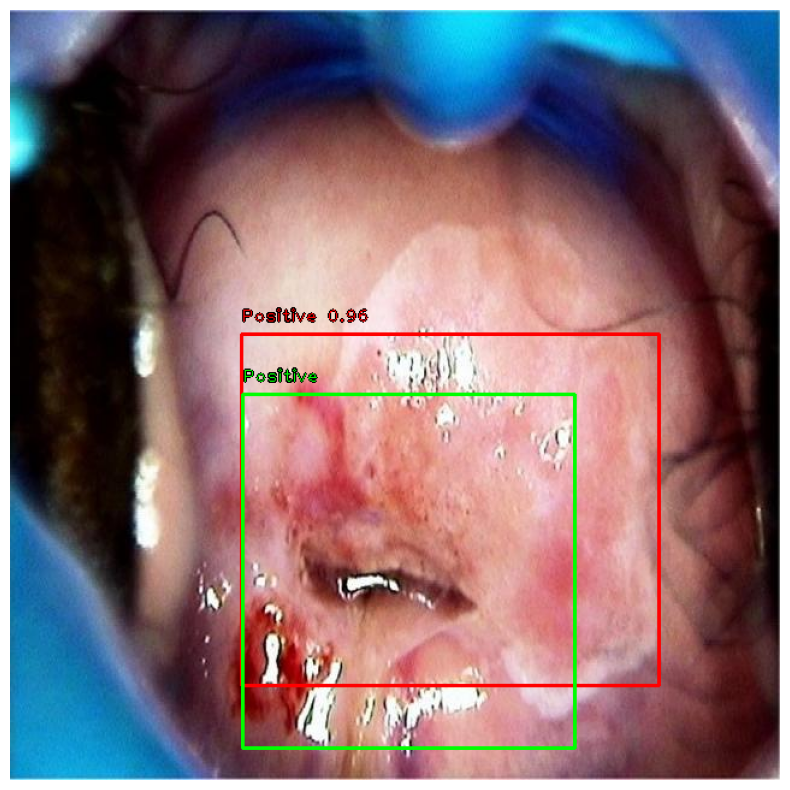

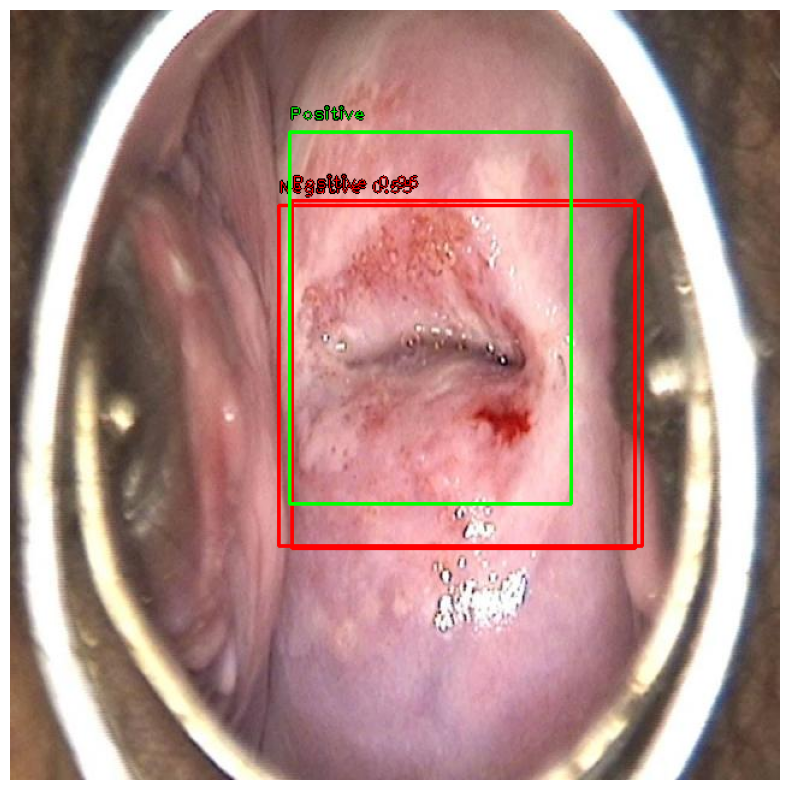

In [21]:
model_path = '/home/toni_intern/RetinaNet/chosen_epoch_weights/coco_retinanet_depth_101_epoch_13.pt'
detect_and_compare(image_dir, model_path, f'{image_dir}/_annotations.coco.json')